# Building graphs for an iteractive multi-page COVID-19 vaccination dashboard app


### Data from OurWorldinData COVID-19 GitHub repository
For more info about the data: 
https://github.com/owid/covid-19-data/blob/master/public/data/README.md

### Graphs to be generated: 

1. New COVID-19 cases and vaccinations overtime per country
2. COVID-19 vaccine manufacturer market share per country
3. Top countries for each COVID-19 vaccine manufacturer 
4. Total number of COVID-19 vaccine doses administered per manufacturer
5. COVID-19 vaccination coverage in relation to GDP


#### Download this notebook to run the interactive graphs on your computer

In [390]:
# Libraries 
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import plotly.express as px
from datetime import datetime
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Data

In [391]:
# timeseries data with incidence, deaths, vaccination coverage, GDP and more for all countries + aggregated data per continent
# 299125+ rows of data 
df = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv')

# timeseries data containing vaccine dose data per manufacturer for 43 countries
# 58440+ rows of data
df_vac_manuf = pd.read_csv('https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations-by-manufacturer.csv')

In [381]:
df.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN


In [382]:
df_vac_manuf.head()

,location,date,vaccine,total_vaccinations
0,Argentina,2020-12-29,Oxford/AstraZeneca,1
1,Argentina,2020-12-29,Sinopharm/Beijing,1
2,Argentina,2020-12-29,Sputnik V,20491
3,Argentina,2020-12-30,Sputnik V,40592
4,Argentina,2020-12-31,Sputnik V,43398


## 1. New COVID-19 cases and vaccinations overtime per country

In [401]:
# filter data for Sweden 

countries = df.loc[df.location == 'Sweden'].copy()
countries['date'] = pd.to_datetime(countries['date'])

# resample the data to get a 7D rolling average 
resampled = countries.set_index('date').resample('7D').mean()

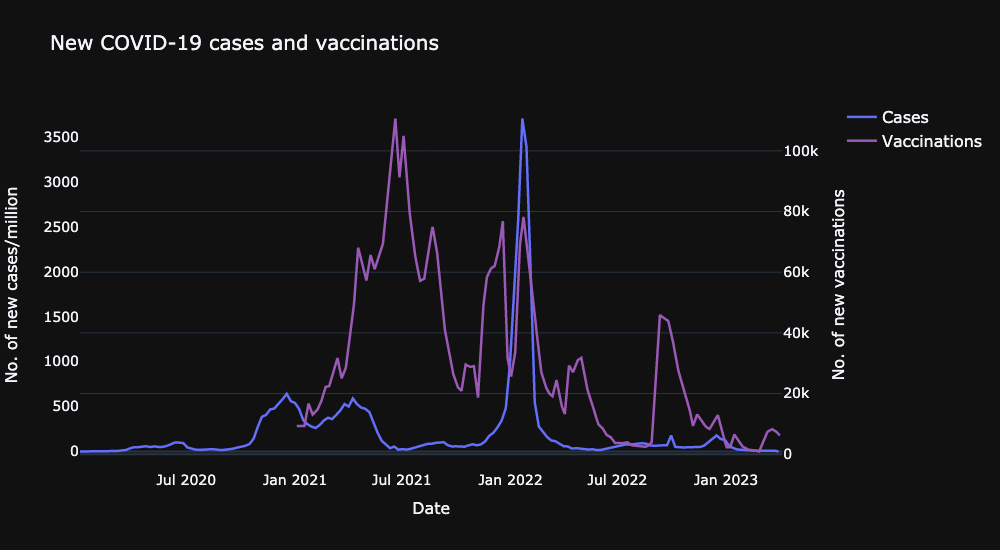

In [395]:
# plot cases and 

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(x=resampled.index, y=resampled.new_cases_per_million, name='Cases',
                         line=dict(width=2.5)), secondary_y=False)
# from original data
fig.add_trace(go.Scatter(x=countries.date, y=countries.new_vaccinations_smoothed, name='Vaccinations',
                         line=dict(color='#9b59b6', width=2.5)), secondary_y=True)

fig.update_layout(title=f"New COVID-19 cases and vaccinations",
                  template='plotly_dark', width=1000, height=550, title_font=dict(size=20),
                  xaxis={'showgrid': False}, yaxis={'showgrid': False},
                  legend_font_size=16)
# Set x-axis title
fig.update_xaxes(title_text="Date", title_font=dict(size=16), tickfont=dict(size=14))

# Set y-axes titles
fig.update_yaxes(title_text="No. of new cases/million", secondary_y=False, title_font=dict(size=16),
                 tickfont=dict(size=14))
fig.update_yaxes(title_text="No. of new vaccinations", secondary_y=True, title_font=dict(size=16),
                 tickfont=dict(size=14))

fig.show('png')

## 2. COVID-19 vaccine manufacturer market share per country

In [398]:
# filter data for Sweden 

country = df_vac_manuf.loc[df_vac_manuf.location == 'Sweden'].copy()
country

,location,date,vaccine,total_vaccinations
42509,Sweden,2021-01-01,Moderna,0
42510,Sweden,2021-01-01,Novavax,0
42511,Sweden,2021-01-01,Oxford/AstraZeneca,0
42512,Sweden,2021-01-01,Pfizer/BioNTech,1397
42513,Sweden,2021-01-08,Pfizer/BioNTech,33874
...,...,...,...,...
42802,Sweden,2023-02-24,Pfizer/BioNTech,17152070
42803,Sweden,2023-03-03,Pfizer/BioNTech,17155428
42804,Sweden,2023-03-10,Pfizer/BioNTech,17158165
42805,Sweden,2023-03-17,Moderna,4149869


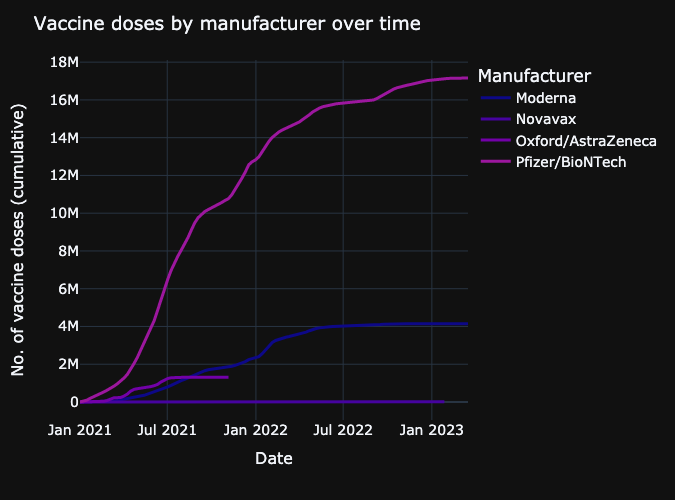

In [396]:
# plot cumulative number of doses by each manufacturer overtime

fig = px.line(country, x="date", y="total_vaccinations",
              color='vaccine',
              template="plotly_dark",
               width=675, height=500,
              color_discrete_sequence= px.colors.sequential.Plasma
               )

fig.update_layout(
    legend_font=dict(size=14),
    title=f"Vaccine doses by manufacturer over time",
    legend_title='Manufacturer', title_font=dict(size=18.5),
    legend_font_size=14)

fig.update_traces(line=dict(width=3))
fig.update_xaxes(title_text="Date", title_font=dict(size=16), tickfont=dict(size=14))
fig.update_yaxes(title_text="No. of vaccine doses (cumulative)", title_font=dict(size=16), tickfont=dict(size=14))

fig.show('png')

In [412]:
# filter data on Sweden and access the latest entry for each vaccine manufacturer 

country = df_vac_manuf.loc[df_vac_manuf.location == 'Sweden'].copy()
country = country.groupby('vaccine')[['total_vaccinations', 'date']].max()
country

,total_vaccinations,date
vaccine,,
Moderna,4149869,2023-03-17
Novavax,7067,2023-01-27
Oxford/AstraZeneca,1313950,2021-11-05
Pfizer/BioNTech,17160697,2023-03-17


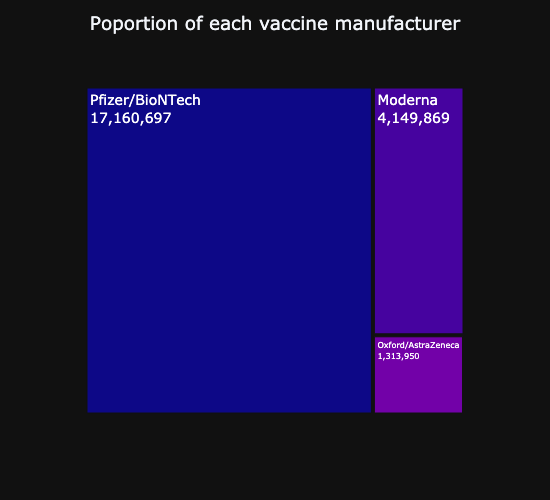

In [413]:
# plot the above values as a treemap to show hte relative share of each vaccine manufacturer 

fig = px.treemap(country, path=[country.index], values='total_vaccinations',
                 template="plotly_dark", width=550, height=500, hover_data=['total_vaccinations'],
                 color_discrete_sequence= px.colors.sequential.Plasma)

fig.update_traces(textinfo='label+value', textfont=dict(size=14))
fig.update_layout(title="Poportion of each vaccine manufacturer",
                      title_x=0.5, title_font=dict(size=18.5))

fig.show('png')


## 3. Top countries for each COVID-19 vaccine manufacturer

In [415]:
# filter vaccine data for Moderna 

vacc_minus_eu = df_vac_manuf.loc[(df_vac_manuf.location != 'European Union') & 
                                 (df_vac_manuf.vaccine == 'Moderna')].copy()

# select top 10 countries based on the number of doses administered 
vacc_totals = vacc_minus_eu.groupby(['location'])[['total_vaccinations','date']].max().nlargest(columns ='total_vaccinations', n = 10).sort_values(by = 'total_vaccinations', ascending = True)
vacc_totals

,total_vaccinations,date
location,,
Switzerland,10638899,2023-04-03
South Korea,13431247,2023-01-29
Argentina,17626891,2023-04-08
France,24128842,2023-04-06
Spain,24368449,2023-03-17
Canada,28804585,2022-12-04
Germany,31586566,2023-04-07
Italy,34337286,2023-04-08
Japan,83386123,2023-04-06


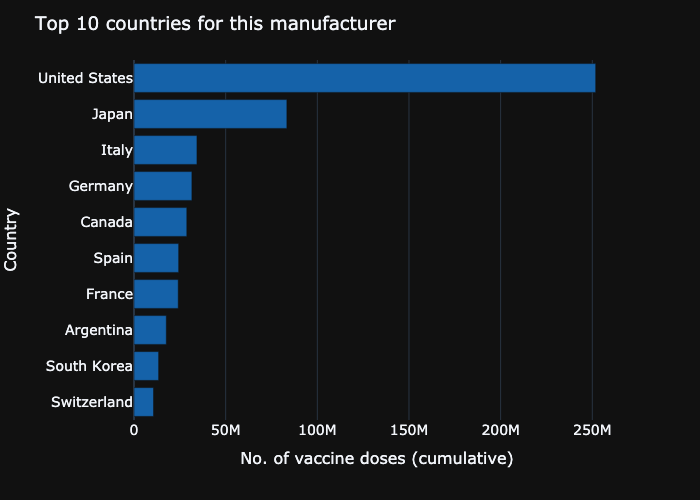

In [416]:
# plot the countries with highest number of doses for Moderna 

fig = px.bar(vacc_totals, y=vacc_totals.index, x='total_vaccinations',log_x = False,
                template="plotly_dark", width=700, height=500, 
            orientation = 'h')
fig.update_layout(showlegend=False, title = f"Top 10 countries for this manufacturer", 
                  title_font=dict(size=18.5))
fig.update_traces(marker_color='#1562A9')

fig.update_xaxes(title_text="No. of vaccine doses (cumulative)", title_font=dict(size=16), tickfont=dict(size=14))
fig.update_yaxes(title_text="Country",title_font=dict(size=16), tickfont=dict(size=14))



fig.show('png')

In [417]:
# access the most recent value of the number of doses by Moderna for all countries

vacc_minus_eu = df_vac_manuf.loc[(df_vac_manuf.location != 'European Union') & (df_vac_manuf.vaccine == 'Moderna')].copy()

vacc_totals = vacc_minus_eu.groupby(['location'])[['total_vaccinations','date']].max()
vacc_totals

,total_vaccinations,date
location,,
Argentina,17626891,2023-04-08
Austria,1665345,2023-03-17
Belgium,4389431,2023-03-17
Bulgaria,511956,2023-03-24
Canada,28804585,2022-12-04
Chile,0,2022-02-07
Croatia,520646,2022-10-21
Cyprus,199741,2023-03-17
Czechia,1641502,2023-04-06


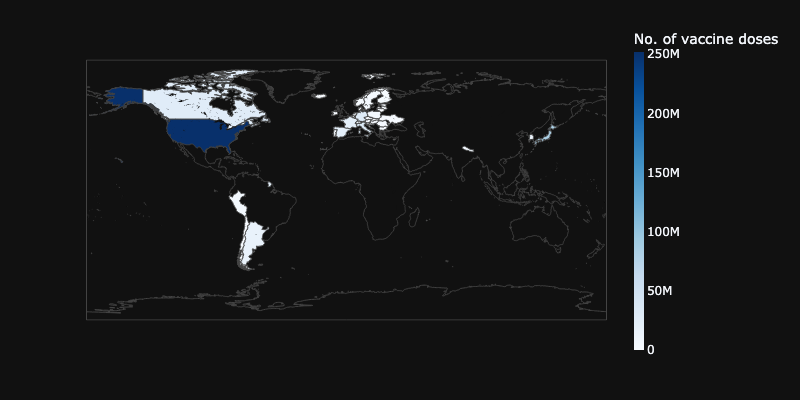

In [418]:
# plot the values above on an interactive map 

fig = go.Figure(data = px.choropleth(vacc_totals, locations=vacc_totals.index,
                    locationmode="country names", color='total_vaccinations', 
                    scope="world", 
                   width=800, 
                    height=400,
                   template="plotly_dark",
                   projection = 'equirectangular',
                   labels={'total_vaccinations': 'No. of vaccine doses'},
                    color_continuous_scale=px.colors.sequential.Blues))



fig.update_geos(visible=True, resolution=50)
fig.update_layout(coloraxis_colorbar=dict(
    thicknessmode="pixels", thickness=10,
    lenmode="pixels", len=340
))


fig.show('png')

## 4. Total number of COVID-19 vaccine doses administered per manufacturer

In [419]:
# sum up all the latest values for the number of vaccine doses administered for each manufacturer  

vacc_minus_eu = df_vac_manuf.loc[df_vac_manuf.location != 'European Union'].copy()
vacc_totals = vacc_minus_eu.groupby(['location', 'vaccine'])[['total_vaccinations','date']].max()
vacc_totals.reset_index(inplace = True)
vacc_totals_fin = vacc_totals.groupby('vaccine')[['total_vaccinations']].sum().sort_values(by = 'total_vaccinations', ascending = False)
vacc_totals_fin

,total_vaccinations
vaccine,
Pfizer/BioNTech,1648225505
Moderna,579186647
Oxford/AstraZeneca,149073833
Sinopharm/Beijing,72537600
Sinovac,63671528
Johnson&Johnson,52380317
Sputnik V,22601074
CanSino,1523708
Novavax,994796


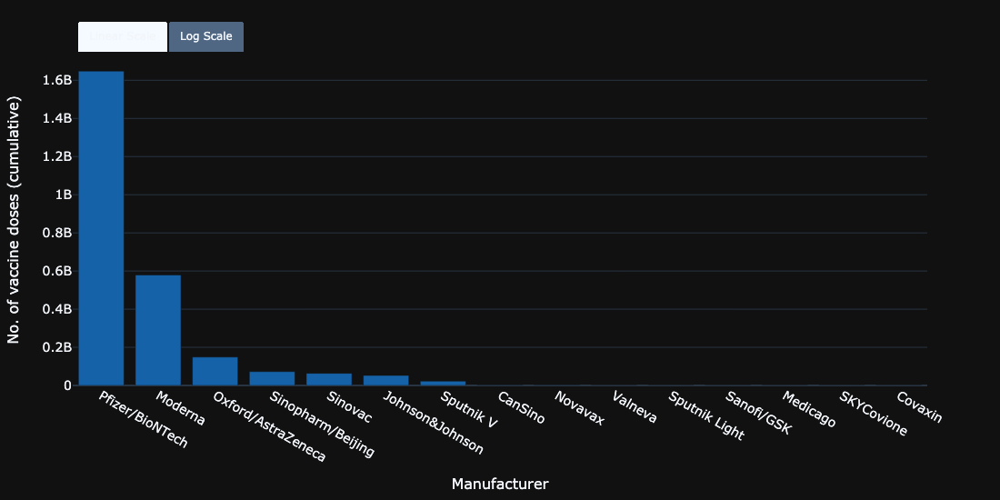

In [420]:
# plot teh values above 

# change to log axis if needed to hover over 
updatemenus= [dict(type="buttons",
                   direction="right",
                   x=0.2,
                   y=1.1,
                   buttons=list([
                               dict(args=[{"yaxis.type": 'linear'}],
                                    label="Linear Scale",
                                    method="relayout"),
                                dict(args=[{"yaxis.type": "log"}],
                                    label="Log Scale",
                                    method="relayout")
                           ])
                          ),
                     ]


fig = px.bar(vacc_totals_fin, x=vacc_totals_fin.index, y='total_vaccinations',log_y = False,
                template="plotly_dark", width=1100, height=550, color = vacc_totals_fin.index)
fig.update_traces(marker_color='#1562A9')

fig.update_layout(showlegend=False, updatemenus=updatemenus)
fig.update_xaxes(title_text="Manufacturer", title_font=dict(size=16), tickfont=dict(size=14))
fig.update_yaxes(title_text="No. of vaccine doses (cumulative)",title_font=dict(size=16), tickfont=dict(size=14))

fig.show('png')

## 5. COVID-19 vaccination coverage in relation to GDP

In [ ]:
import warnings
warnings.filterwarnings("ignore") # for regex below

In [421]:
# remove data that was aggregated by OWID 
countries = df.loc[(df.iso_code.str.contains(r'^((?!OWID_).)*$')) & (df.date > '2020-11-01')].copy()

# calculate percentage of vaccinated people per country 
countries['percent_fully_vacc'] = countries['people_fully_vaccinated'] * 100/ countries['population']

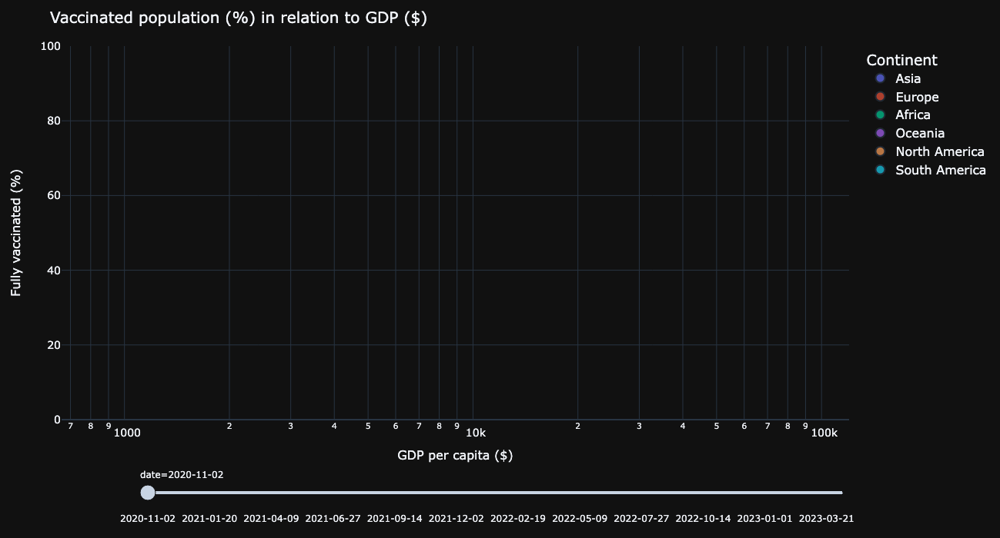

In [422]:
# plot percentage of vaccinated people per country vs GDP overtime 

fig = px.scatter(countries, x="gdp_per_capita", y="percent_fully_vacc", 
                 animation_frame="date", animation_group="location", size="population", 
                 color="continent", hover_name="location", log_x=True, 
                 size_max=55, range_x=[660,120000], range_y=[0,100])

fig.update_layout(title = "Vaccinated population (%) in relation to GDP ($)", 
                  template='plotly_dark', width=800, height=700, title_font=dict(size=20), 
                 legend_font_size=16, legend_title = 'Continent')

# Set x-axis title
fig.update_xaxes(title_text="GDP per capita ($)", title_font=dict(size=16), tickfont=dict(size=14))

# Set y-axes titles
fig.update_yaxes(title_text="Fully vaccinated (%)", title_font=dict(size=16), tickfont=dict(size=14))



fig["layout"].pop("updatemenus") # optional, drop animation buttons

fig.show() 

### Higher GDP countries started vaccinating their populations much earlier than lower GDP countries and overall achieved higher vaccination coverage to date 

### To visualize this graph you will need to download the notebook and run it on your computer